In [1]:
import xarray as xr
import matplotlib.pyplot as plt

import cartopy.crs as ccrs
import fv3viz
import cftime
from datetime import timedelta
import vcm
from vcm.cubedsphere.grid_metadata import GridMetadataScream

In [2]:
plt.rcParams["figure.dpi"] = 120 

In [45]:
def plot_single(ds, varname, ax=None, determine_cmap=False, **kwargs):
    grid_metadata = GridMetadataScream("ncol", "lon", "lat")
    if ax is None:
        fig, ax = plt.subplots(
            figsize=(6, 3), dpi=120, subplot_kw={"projection": ccrs.Robinson()}
        )
    
    if determine_cmap:
        vmin, vmax, cmap = fv3viz.infer_cmap_params(ds[varname], robust=True)
        kwargs = dict(vmin=vmin, vmax=vmax, cmap=cmap)
        
    fv3viz.plot_cube(
        ds,
        varname,
        grid_metadata=grid_metadata,
        ax=ax,
        **kwargs
    )
    
    
def plot_component_panels(ds, num_times, step_size=1, plot_vars=("q2", "<d/n>q2", "pq2"), mean=True, storage=True, last_panel_diff=False):
    grid_metadata = GridMetadataScream("ncol", "lon", "lat")
    for i in range(num_times):
        fig, ax = plt.subplots(
            1, 3,
            figsize=(16, 6), dpi=120, subplot_kw={"projection": ccrs.Robinson()}
        ) 
        vmin, vmax, cmap = fv3viz.infer_cmap_params(ds[plot_vars[0]], robust=True)
        for j, varname in enumerate(plot_vars):
            tidx = i*step_size
            dat = ds[varname].isel(time=tidx)
            title = f"{varname}"
            if mean:
                title += f"\nmean={dat.weighted(ds.area).mean().values:1.2e} kg/m**2/s"
            if storage:
                title += f"\nstorage={(dat * ds.area * 30 * 60).sum().values:1.2e} kg"
            if j == 1:
                title = f"time={dat.time.values.item()}\n" + title
            if j == len(plot_vars) - 1 and last_panel_diff:
                vmin, vmax, cmap = fv3viz.infer_cmap_params(ds[varname], robust=True)
            fv3viz.plot_cube(
                ds.isel(time=tidx),
                varname,
                grid_metadata=grid_metadata,
                ax=ax[j],
                vmin=vmin,
                vmax=vmax,
                cmap=cmap
            )
            ax[j].set_title(title, size=10)
            plt.subplots_adjust(left=0.01, right=0.75, bottom=0.02)
        plt.show() 

In [4]:
path = "/pscratch/sd/a/adonahue/Corrective-ML/20240304_NOT_remapped.F2010-SCREAMv1.ne30pg2_ne30pg2.pm-gpu/tests/20x1_1x1_ndays_nudged/run/output.scream.AVERAGE.nhours_x3.2010*.nc"
files = !ls {path}

In [5]:
to_open = '/pscratch/sd/a/adonahue/Corrective-ML/20240304_NOT_remapped.F2010-SCREAMv1.ne30pg2_ne30pg2.pm-gpu/tests/20x1_1x1_ndays_nudged/run/output.scream.AVERAGE.nhours_x3.2010-01-29-00000.nc'

In [6]:
src_nudged = xr.open_dataset(to_open)

In [7]:
lat = src_nudged.lat
lon = src_nudged.lon

## Do nudging tendencies look reasonable here? 

In [6]:
t3h_nudged = src_nudged.sel(time=cftime.DatetimeNoLeap(2010, 2, 1, 3))

In [18]:
q1 = vcm.column_integrated_heating_from_isochoric_transition(t3h_nudged.physics_T_mid_tend, t3h_nudged.pseudo_density, vertical_dim="lev")
nq1 = vcm.column_integrated_heating_from_isochoric_transition(t3h_nudged.nudging_T_mid_tend, t3h_nudged.pseudo_density, vertical_dim="lev")
phys = q1 - nq1

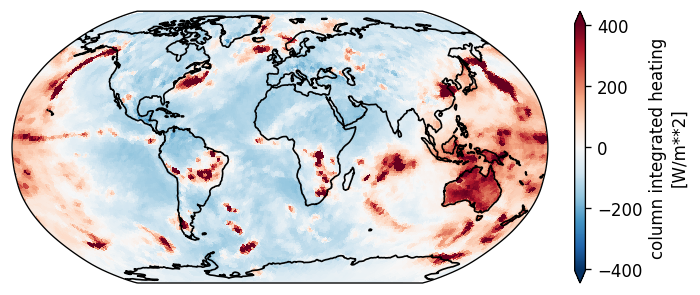

In [15]:
plot_single(xr.Dataset(dict(q1=q1, lat= t3h_nudged.lat, lon = t3h_nudged.lon)), "q1", determine_cmap=True)

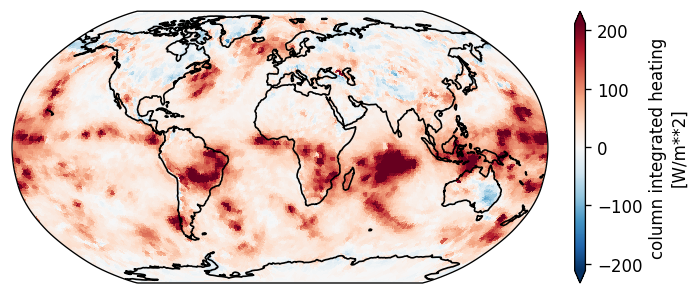

In [17]:
plot_single(xr.Dataset(dict(nq1=nq1, lat= t3h_nudged.lat, lon = t3h_nudged.lon)), "nq1", determine_cmap=True)

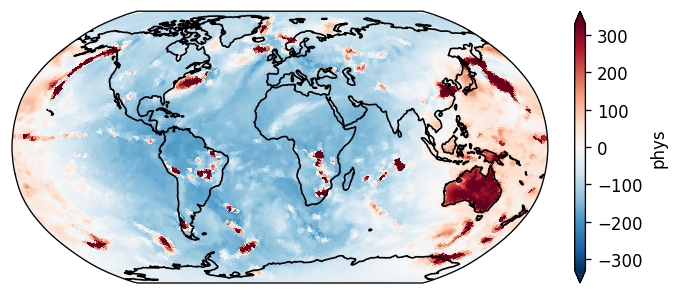

In [19]:
plot_single(xr.Dataset(dict(phys=phys, lat= t3h_nudged.lat, lon = t3h_nudged.lon)), "phys", determine_cmap=True)

In [20]:
q2 = vcm.mass_integrate(t3h_nudged.physics_qv_tend, t3h_nudged.pseudo_density, dim="lev")
nq2 = vcm.mass_integrate(t3h_nudged.nudging_qv_tend, t3h_nudged.pseudo_density, dim="lev")
pq2 = q2 - nq2

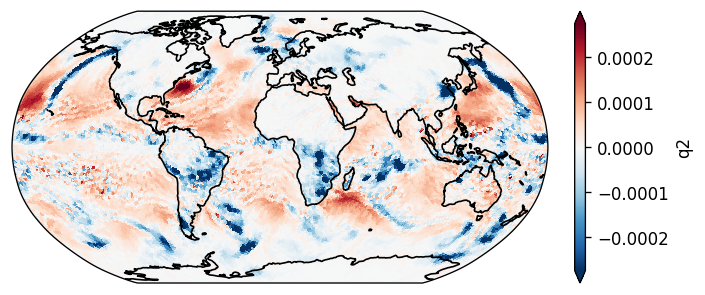

In [21]:
plot_single(xr.Dataset(dict(q2=q2, lat= t3h_nudged.lat, lon = t3h_nudged.lon)), "q2", determine_cmap=True)

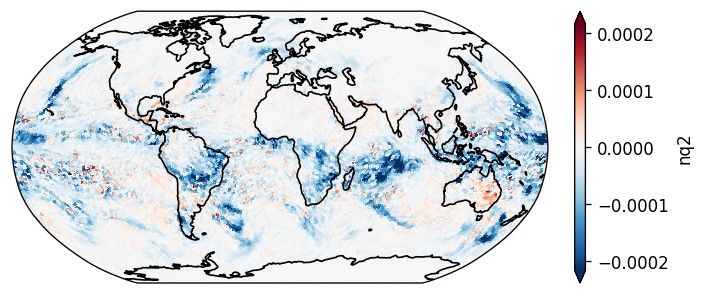

In [22]:
plot_single(xr.Dataset(dict(nq2=nq2, lat= t3h_nudged.lat, lon = t3h_nudged.lon)), "nq2", determine_cmap=True)

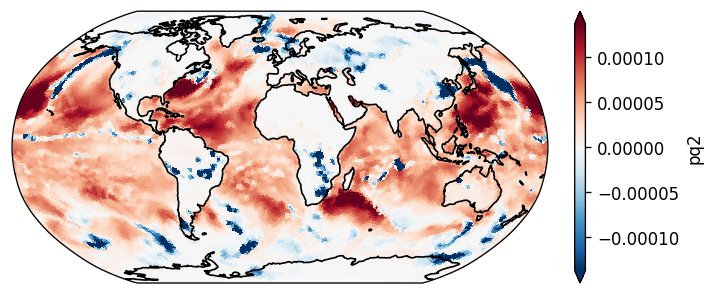

In [23]:
plot_single(xr.Dataset(dict(pq2=pq2, lat= t3h_nudged.lat, lon = t3h_nudged.lon)), "pq2", determine_cmap=True)

This looks much better. Looks like there's a variable problem in the other notebook

## Check storage differences between nudged simulation and ML nudged restart 

In [22]:
times = [cftime.DatetimeNoLeap(2010, 2, 1, 3) + timedelta(hours=3) * i for i in range(16)]

In [23]:
ml_nrestart_path = "/pscratch/sd/a/adonahue/Corrective-ML/20240517_from_ruby_TqUVR_chk/*.nc"
ml_restart_files = !ls {ml_nrestart_path}
all_ds = [xr.open_dataset(f, use_cftime=True) for f in ml_restart_files]

In [24]:
varnames = ["VapWaterPath", "physics_qv_tend", "mlcorrection_qv_tend", "surf_evap", "precip_ice_surf_mass_flux", "precip_liq_surf_mass_flux", "pseudo_density", "area", "lat", "lon"]

In [19]:
ml_nrestart = xr.concat([d[varnames] for d in all_ds[0:2]], dim="time", coords="minimal")

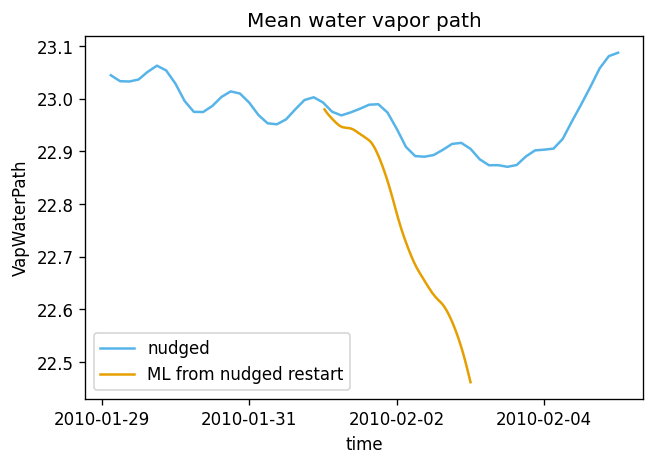

In [88]:
src_nudged.VapWaterPath.weighted(src_nudged.area).mean(dim="ncol").plot(label="nudged")
ml_nrestart.VapWaterPath.weighted(ml_nrestart.area).mean(dim="ncol").plot(label="ML from nudged restart")
plt.title("Mean water vapor path")
plt.legend()
plt.show()

Mean column integrated qv really starts to drop off after first few hours into the simulation

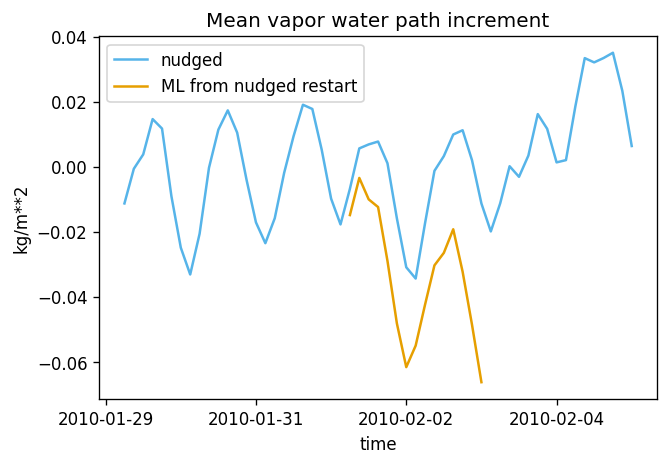

In [91]:
src_nudged.VapWaterPath.weighted(src_nudged.area).mean(dim="ncol").diff("time").plot(label="nudged")
ml_nrestart.VapWaterPath.weighted(ml_nrestart.area).mean(dim="ncol").sel(time=times).diff("time").plot(label="ML from nudged restart")
plt.title("Mean vapor water path increment")
plt.ylabel("kg/m**2")
plt.legend()
plt.show()

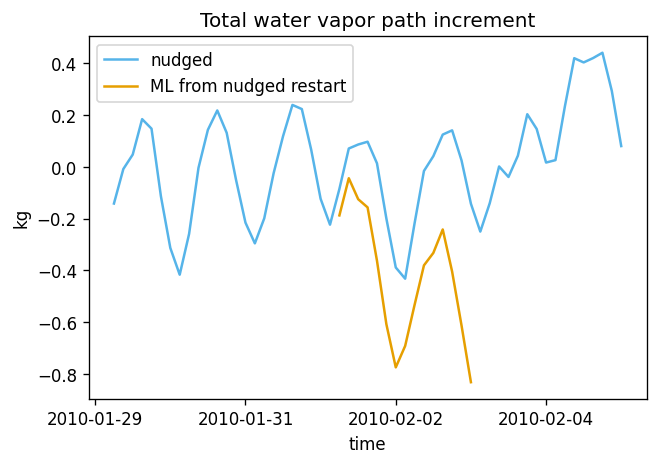

In [93]:
(src_nudged.VapWaterPath * src_nudged.area).sum(dim="ncol").diff("time").plot(label="nudged")
(ml_nrestart.VapWaterPath * ml_nrestart.area).sum(dim="ncol").sel(time=times).diff("time").plot(label="ML from nudged restart")
plt.title("Total water vapor path increment")
plt.ylabel("kg")
plt.legend()
plt.show()

## Nudged simulation
### Spatial plots of `Q2`, `nQ2`, and `pQ2` at initial timesteps

In [25]:
delp = src_nudged.pseudo_density.sel(time=times)
nudged_q2 = vcm.mass_integrate(src_nudged.physics_qv_tend.sel(time=times), delp, dim="lev")
nudged_nq2 = vcm.mass_integrate(src_nudged.nudging_qv_tend.sel(time=times), delp, dim="lev")
nudged_pq2 = nudged_q2 - nudged_nq2

nudge_ds = xr.Dataset({"pq2": nudged_pq2, "<d/n>q2": nudged_nq2, "q2": nudged_q2, "lat": lat, "lon": lon, "area": src_nudged.area})

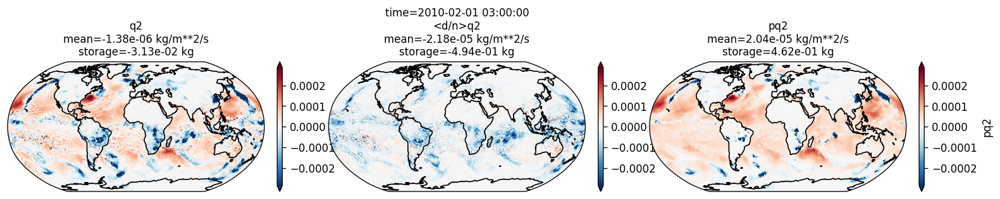

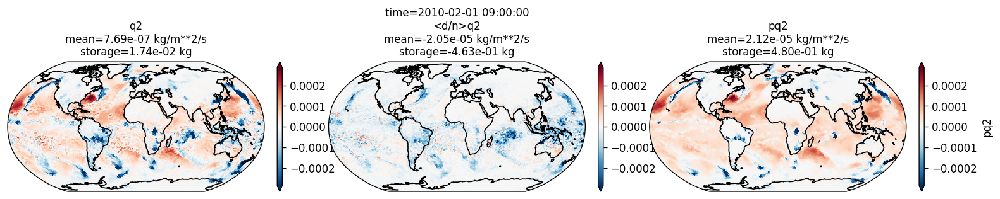

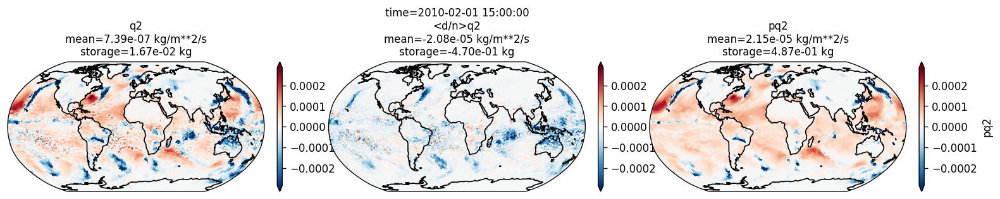

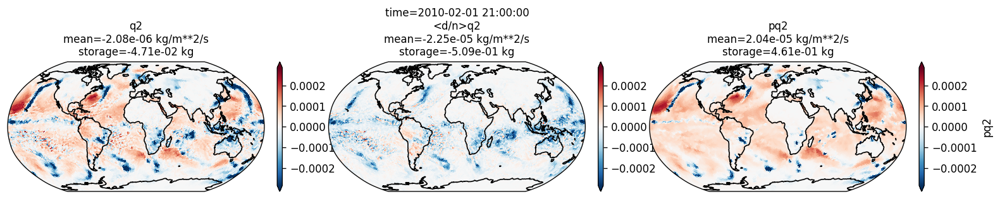

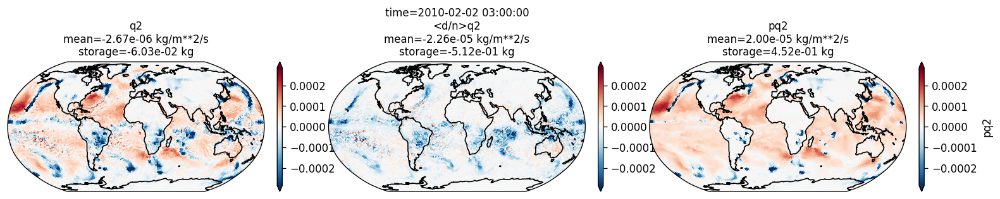

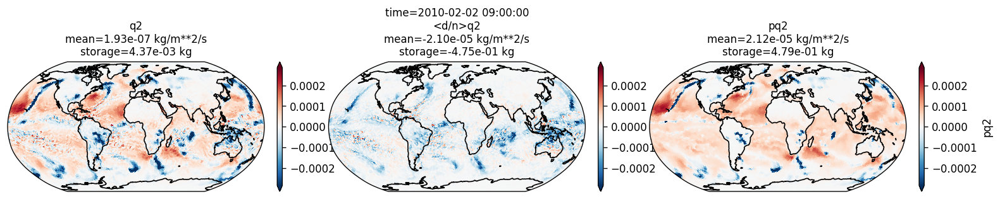

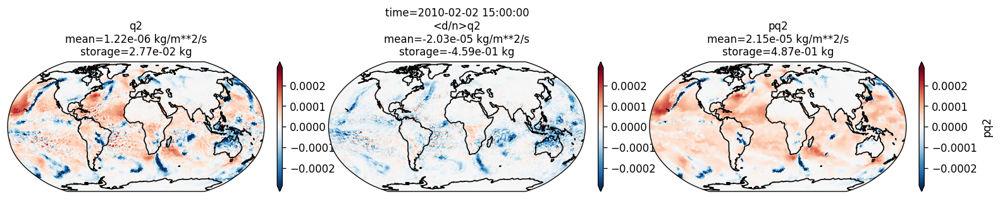

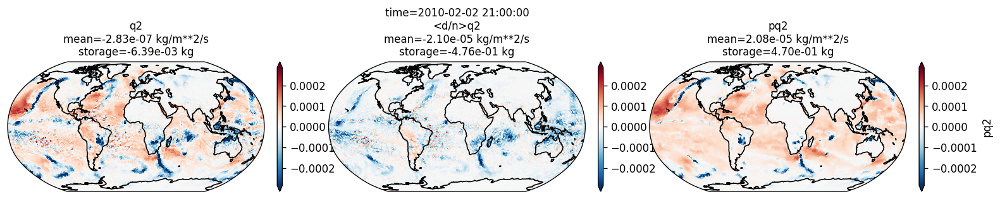

In [25]:
plot_component_panels(nudge_ds, 8, step_size=2)

## ML simulation initialized from nudged run restart
### Spatial plots of `d2`, `nQ2`, and `pQ2` at initial timesteps

In [26]:
delp = ml_nrestart.pseudo_density.sel(time=times)
ml_q2 = vcm.mass_integrate(ml_nrestart.physics_qv_tend.sel(time=times), delp, dim="lev")
ml_dq2 = vcm.mass_integrate(ml_nrestart.mlcorrection_qv_tend.sel(time=times), delp, dim="lev")
ml_pq2 = ml_q2 - ml_dq2

In [27]:
ml_ds = xr.Dataset({"pq2": ml_pq2, "<d/n>q2": ml_dq2, "q2": ml_q2, "lat": lat, "lon": lon, "area": ml_nrestart.area.isel(time=0)})

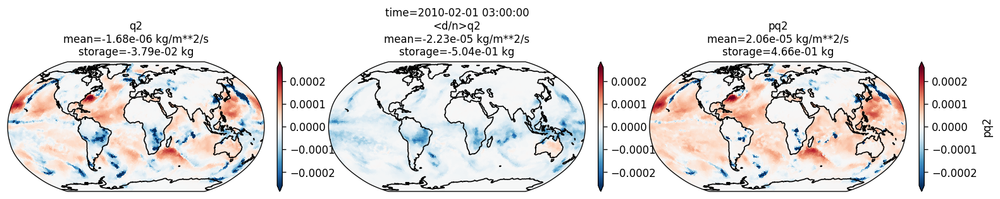

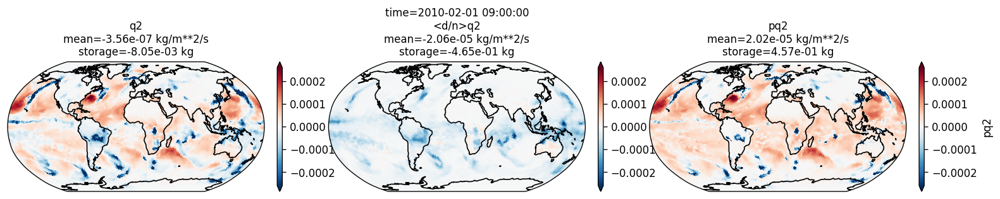

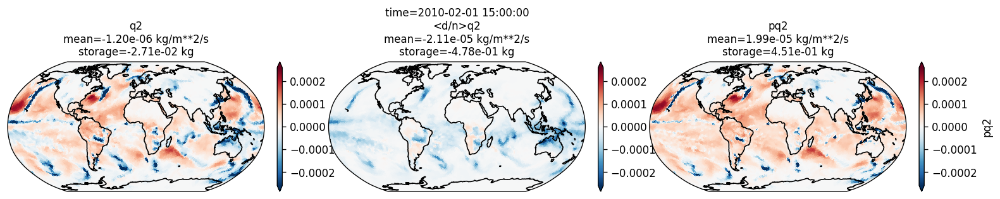

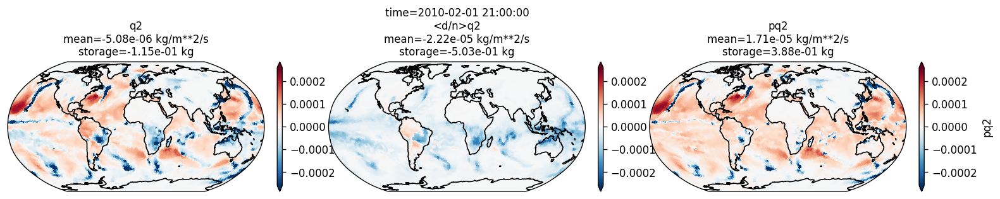

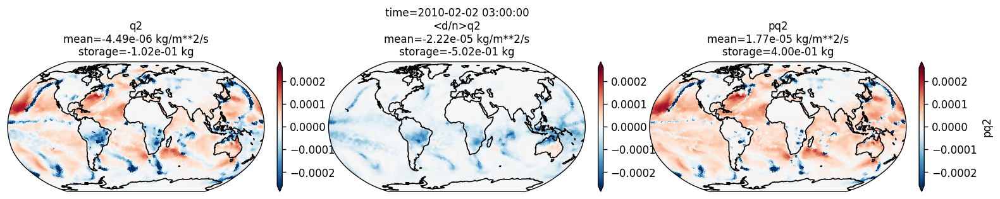

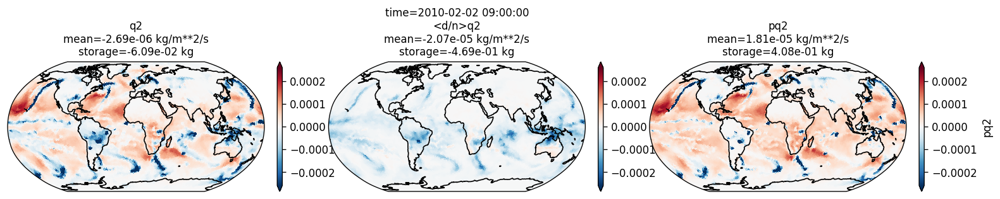

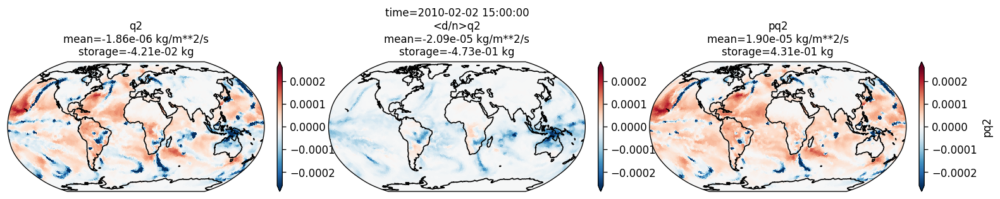

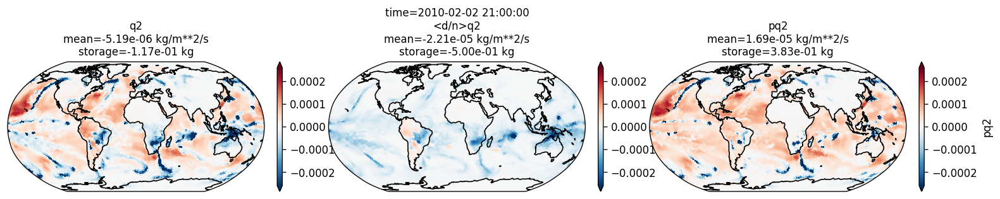

In [38]:
plot_component_panels(ml_ds, 8, step_size=2)

## Difference of ML run started from nudged restart and nudged simulation
### Spatial difference plots of `Q2`, `<d/n>Q2`, and `pQ2` at initial timesteps

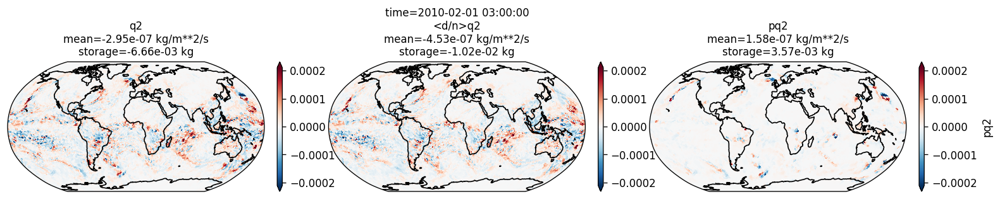

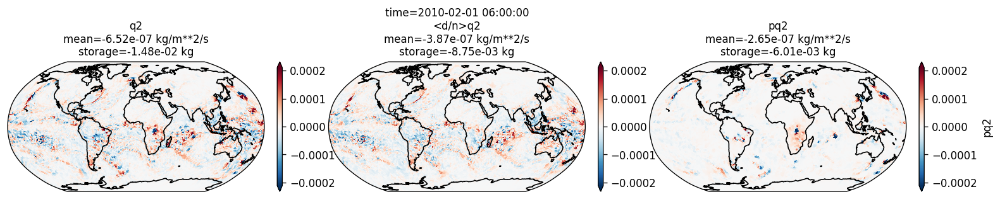

In [39]:
diff_ds = ml_ds - nudge_ds
diff_ds = diff_ds.update({"lat": lat, "lon": lon, "area": ml_nrestart.area.isel(time=0)})
plot_component_panels(diff_ds, 2)

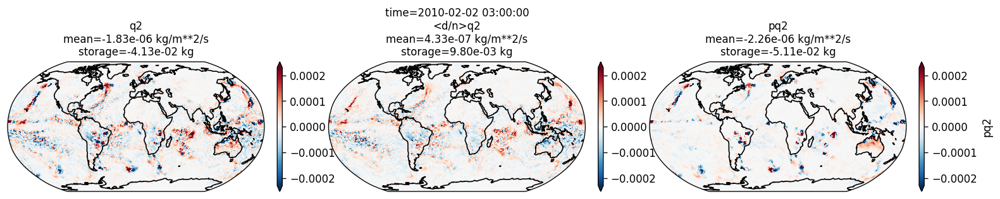

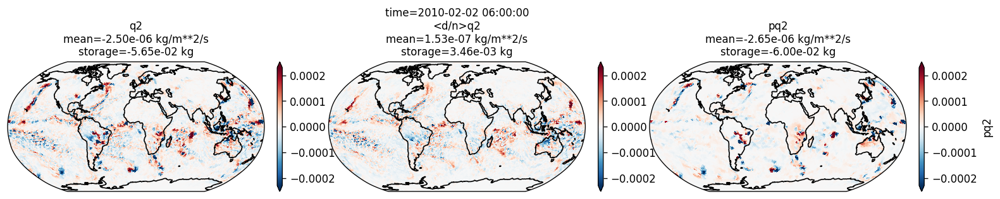

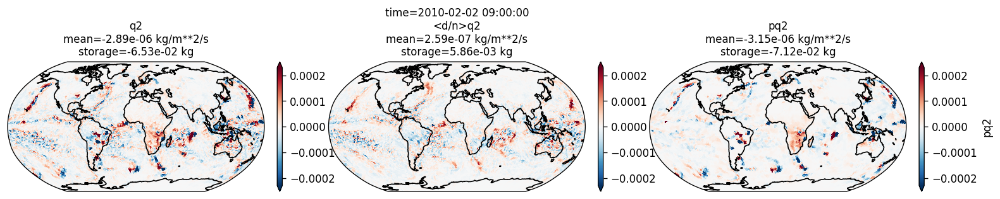

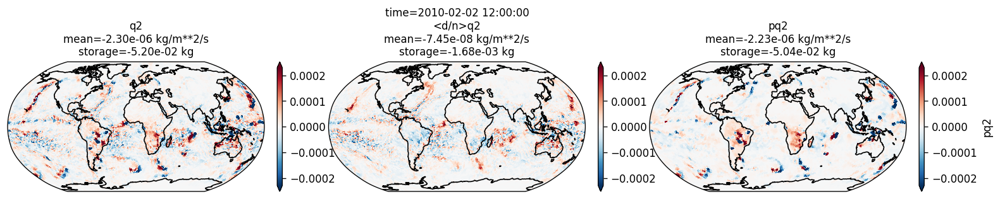

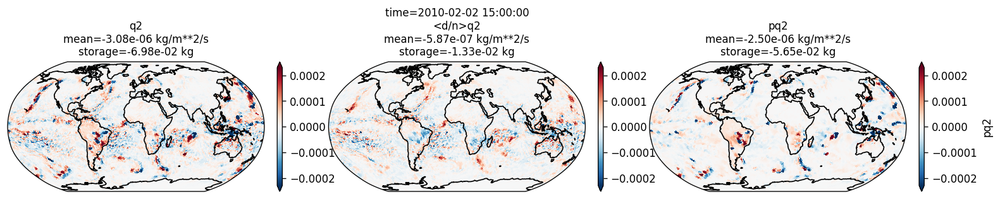

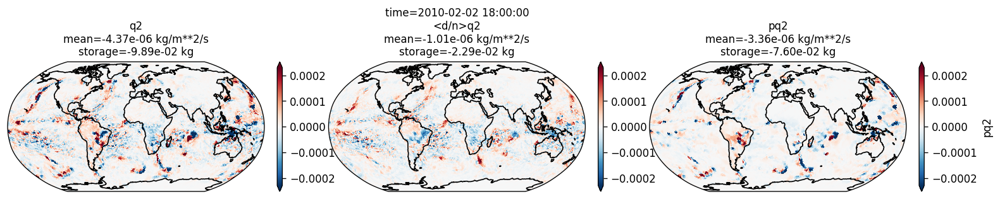

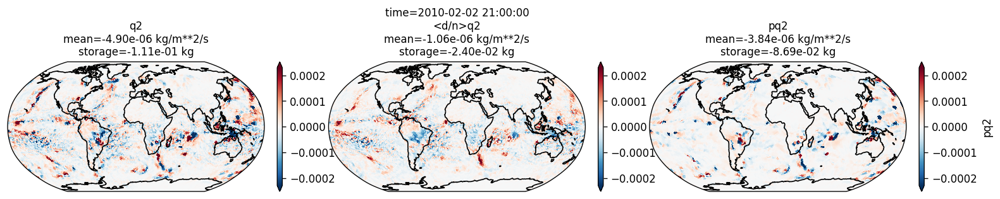

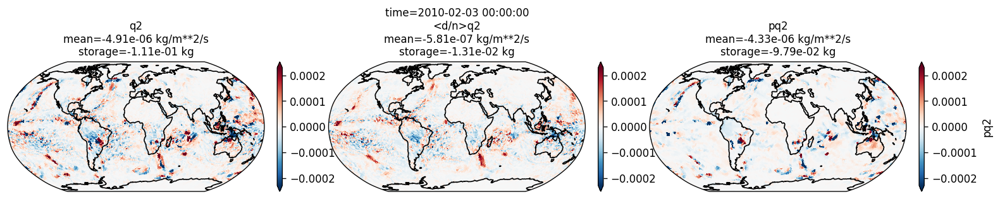

In [40]:
diff_ds = ml_ds - nudge_ds
diff_ds = diff_ds.update({"lat": lat, "lon": lon, "area": ml_nrestart.area.isel(time=0)})
plot_component_panels(diff_ds.isel(time=slice(8, None)), 8)

## Surface evaporation differences 

In [15]:
ml_evap = ml_nrestart.sel(time=times).surf_evap
nudge_evap = src_nudged.sel(time=times).surf_evap
diff_evap = ml_evap - nudge_evap

In [41]:
evap_ds = xr.Dataset({"nudged": nudge_evap, "ml": ml_evap, "diff": diff_evap, "lat": lat, "lon": lon, "area": ml_nrestart.area.isel(time=0)})

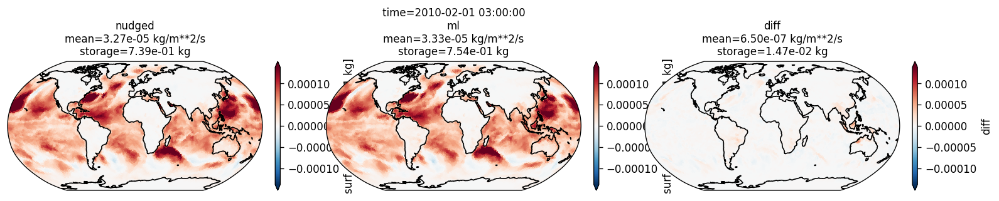

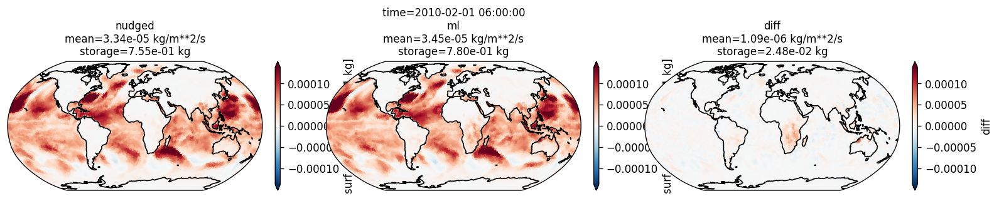

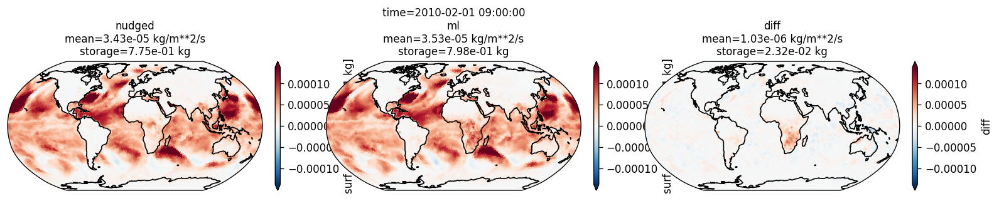

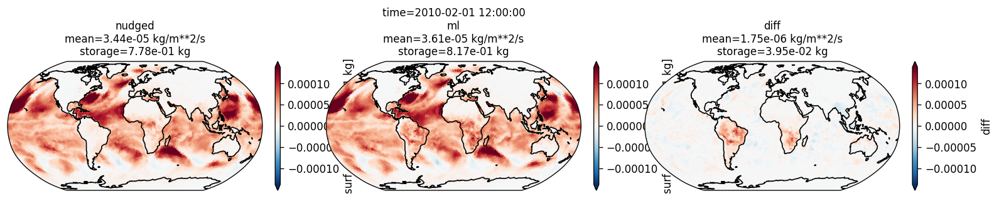

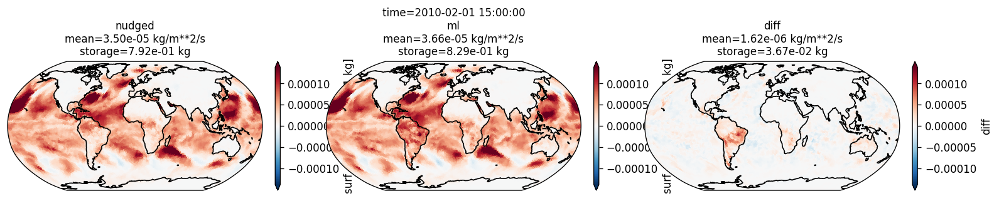

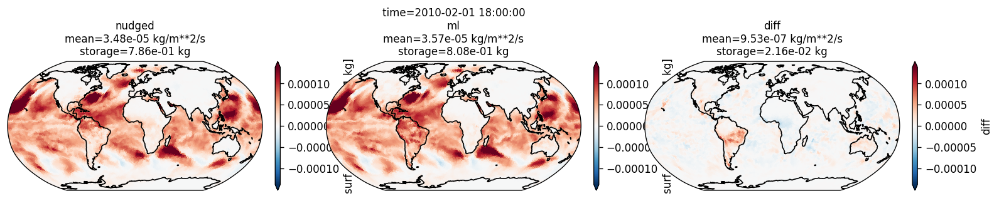

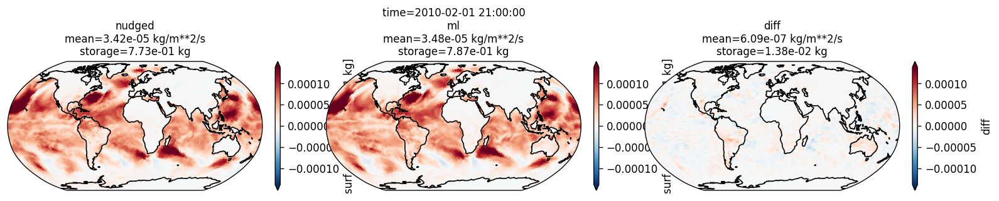

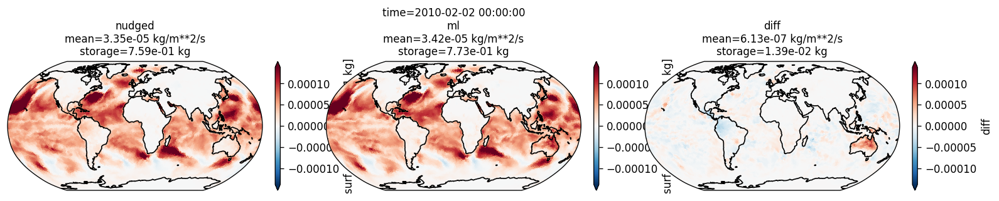

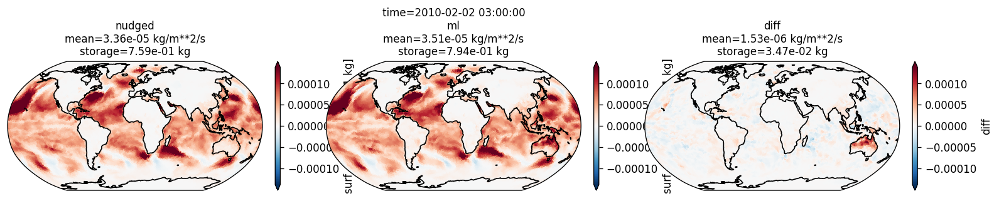

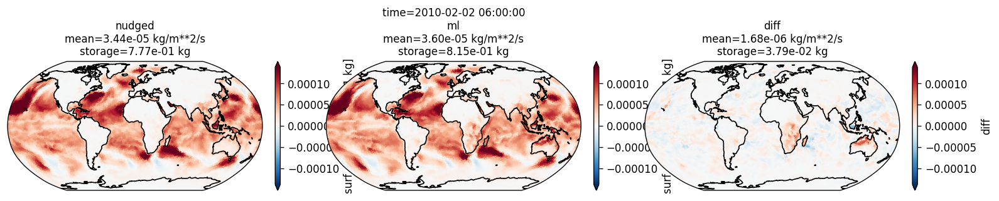

In [45]:
plot_component_panels(evap_ds, 10, plot_vars=("nudged", "ml", "diff"))

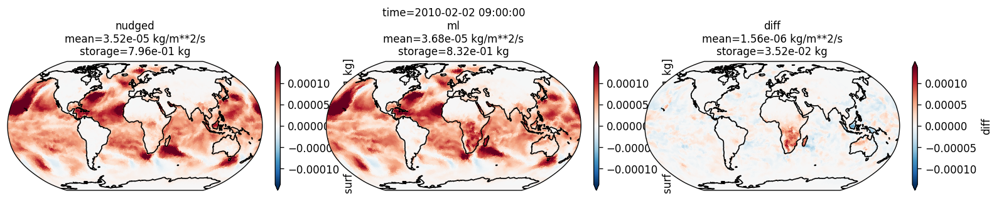

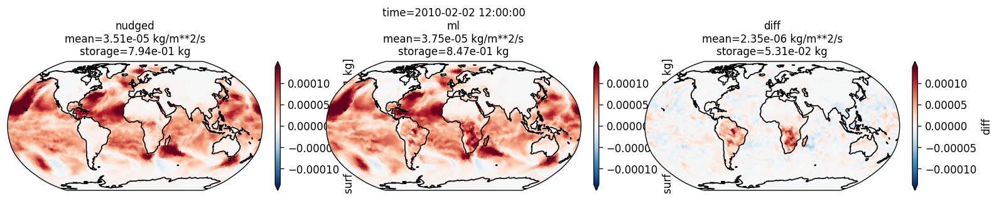

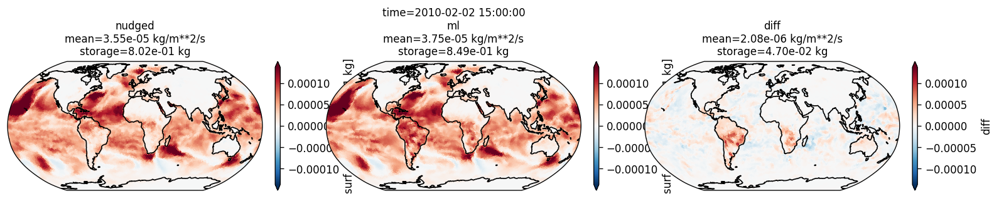

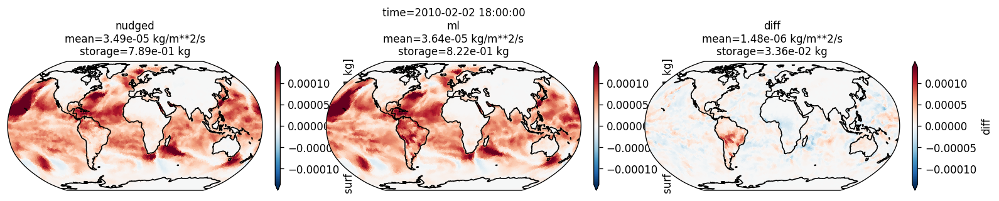

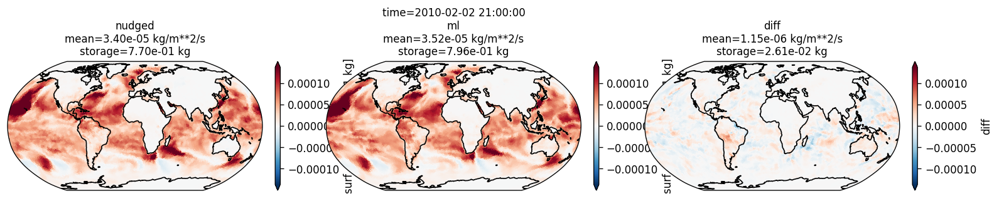

In [ ]:
plot_component_panels(evap_ds.isel(time=slice(10, None)), 6, plot_vars=("nudged", "ml", "diff"))

## Precipitation 

In [61]:
ml_total_pr = (ml_nrestart.precip_ice_surf_mass_flux + ml_nrestart.precip_liq_surf_mass_flux).sel(time=times) * 1000
ml_phys_pr = ml_total_pr + ml_dq2

In [64]:
nudge_phys_pr = (src_nudged.precip_ice_surf_mass_flux + src_nudged.precip_liq_surf_mass_flux).sel(time=times) * 1000
nudge_total_pr = nudge_phys_pr - nudged_nq2

In [65]:
total_pr_ds = xr.Dataset({"nudged": nudge_total_pr, "ml": ml_total_pr, "diff": ml_total_pr - nudge_total_pr, "lat": lat, "lon": lon, "area": ml_nrestart.area.isel(time=0)})

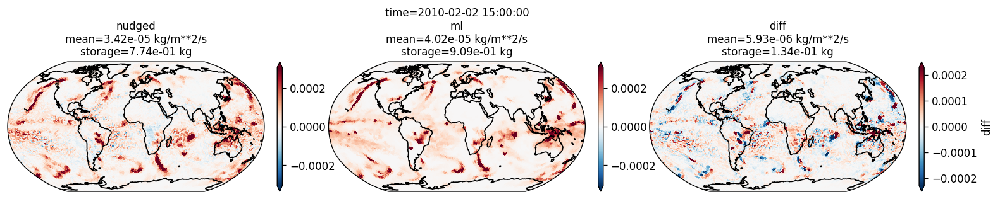

In [66]:
plot_component_panels(total_pr_ds.isel(time=slice(-4, -3)), 1, plot_vars=("nudged", "ml", "diff"), last_panel_diff=True)

In [67]:
phys_pr_ds = xr.Dataset({"nudged": nudge_phys_pr, "ml": ml_phys_pr, "diff": ml_phys_pr - nudge_phys_pr, "lat": lat, "lon": lon, "area": ml_nrestart.area.isel(time=0)})

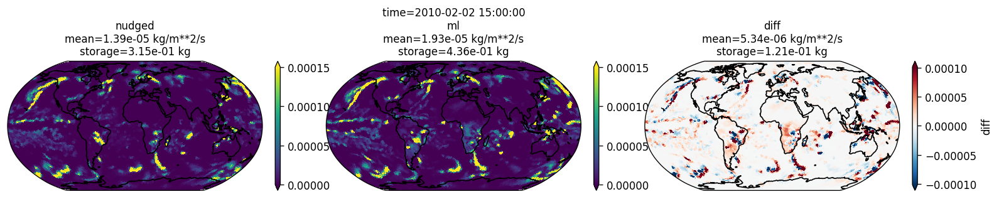

In [68]:
plot_component_panels(phys_pr_ds.isel(time=slice(-4, -3)), 1, plot_vars=("nudged", "ml", "diff"), last_panel_diff=True)

## Zonal average comparison of `Q2`, `<d/n>Q2` and `pQ2`

In [95]:
import numpy as np

In [156]:
bins = np.linspace(-90, 90, 31)

In [157]:
bins

array([-90., -84., -78., -72., -66., -60., -54., -48., -42., -36., -30.,
       -24., -18., -12.,  -6.,   0.,   6.,  12.,  18.,  24.,  30.,  36.,
        42.,  48.,  54.,  60.,  66.,  72.,  78.,  84.,  90.])

In [158]:
zonal_ml_ds = ml_ds.groupby_bins("lat", bins=bins).mean()

In [159]:
zonal_nudge_ds = nudge_ds.groupby_bins("lat", bins=bins).mean()

In [160]:
zonal_diff_ds = zonal_ml_ds - zonal_nudge_ds

### For each time plot the zonal mean moisture tendencies w/ components

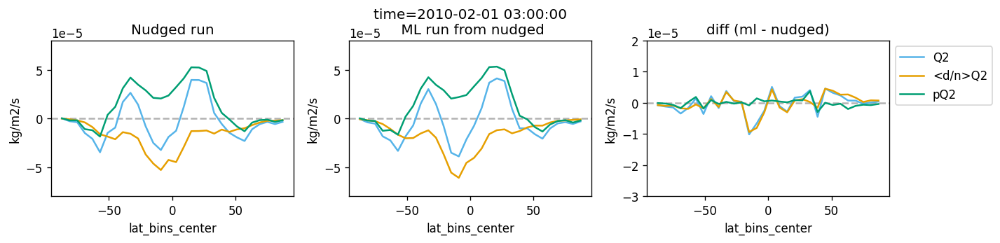

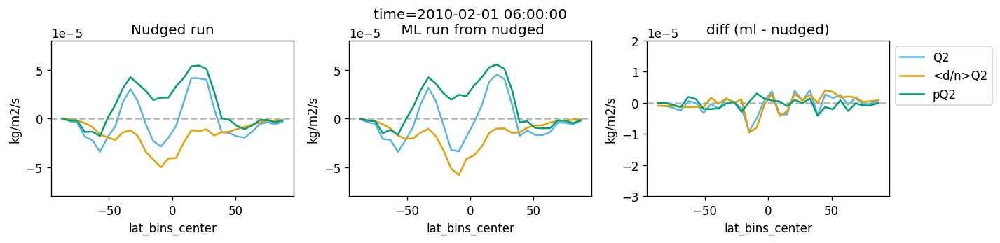

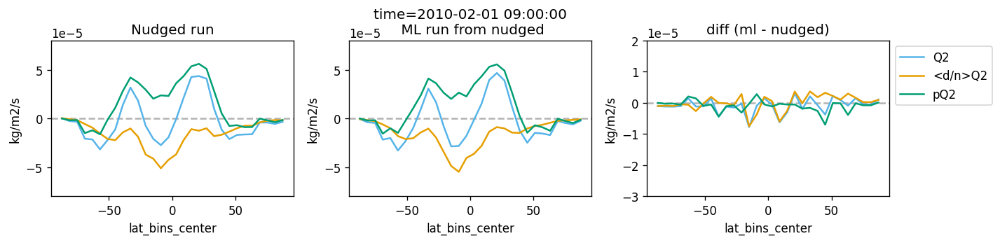

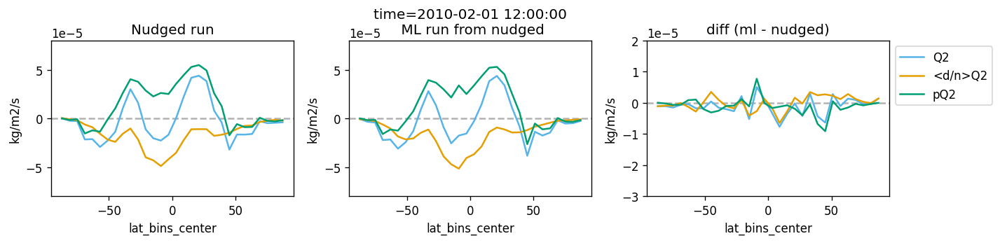

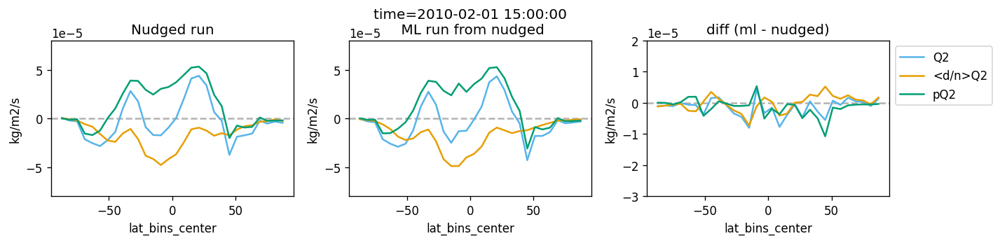

...

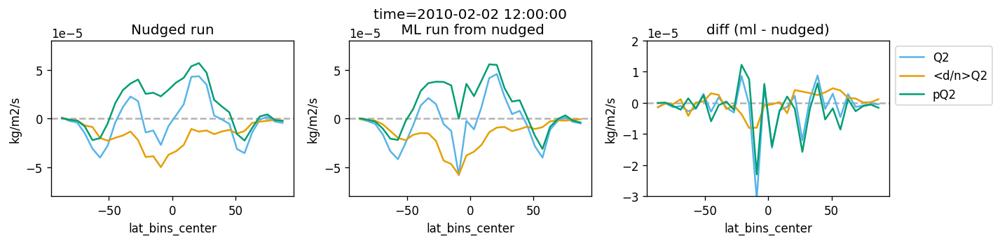

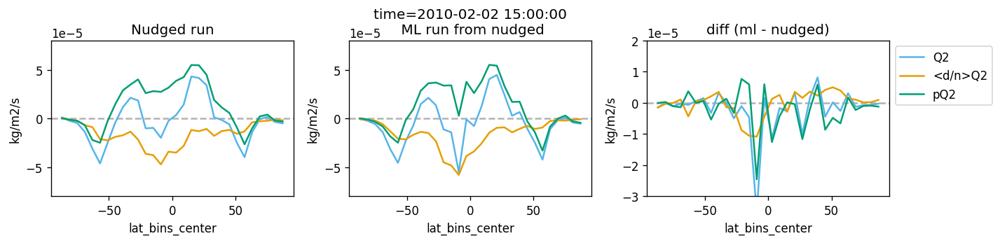

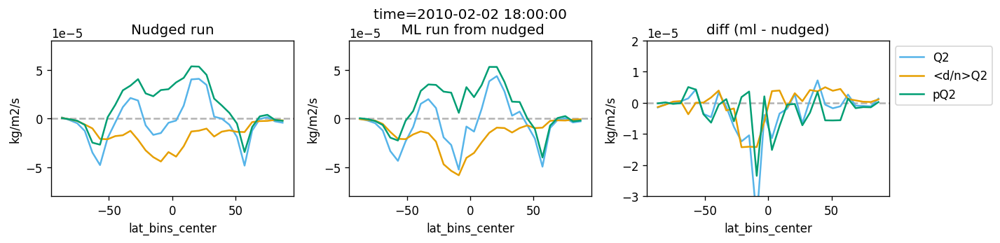

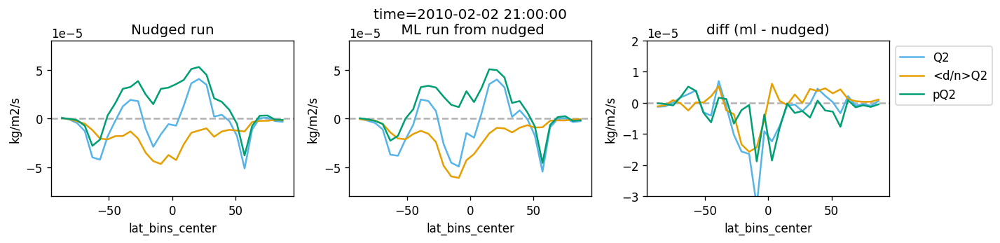

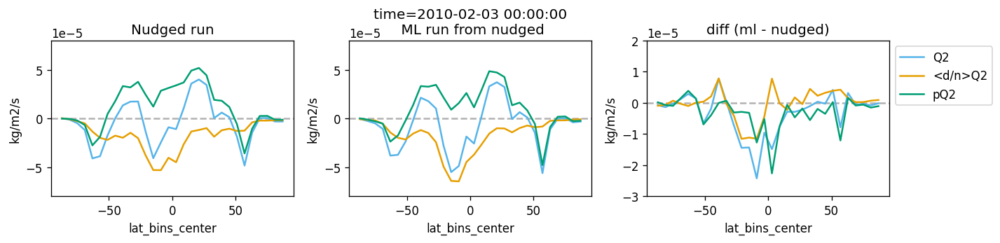

In [169]:
ylim = (-8e-5, 8e-5)
for t in times:
    fig, ax = plt.subplots(1, 3, figsize=(12, 3))
    ax[0].axhline(y=0, color="k", alpha=0.3, linestyle="--")
    zonal_nudge_ds.q2.sel(time=t).plot(label="Q2", ax=ax[0])
    zonal_nudge_ds["<d/n>q2"].sel(time=t).plot(label="dQ2", ax=ax[0])
    zonal_nudge_ds.pq2.sel(time=t).plot(label="pQ2", ax=ax[0])
    ax[0].set_title("Nudged run")
    ax[0].set_ylabel("kg/m2/s")
    ax[0].set_ylim(*ylim)
    
    
    ax[1].axhline(y=0, color="k", alpha=0.3, linestyle="--")
    zonal_ml_ds.q2.sel(time=t).plot(label="Q2", ax=ax[1])
    zonal_ml_ds["<d/n>q2"].sel(time=t).plot(label="dQ2", ax=ax[1])
    zonal_ml_ds.pq2.sel(time=t).plot(label="pQ2", ax=ax[1])
    ax[1].set_title(f"time={zonal_nudge_ds.time.sel(time=t).values.item()}\n ML run from nudged")
    ax[1].set_ylabel("kg/m2/s")
    ax[1].set_ylim(*ylim)
    
    ax[2].axhline(y=0, color="k", alpha=0.3, linestyle="--")
    zonal_diff_ds.q2.sel(time=t).plot(label="Q2", ax=ax[2])
    zonal_diff_ds["<d/n>q2"].sel(time=t).plot(label="<d/n>Q2", ax=ax[2])
    zonal_diff_ds.pq2.sel(time=t).plot(label="pQ2", ax=ax[2])
    ax[2].set_title("diff (ml - nudged)")
    ax[2].set_ylabel("kg/m2/s")
    ax[2].set_ylim(-3e-5, 2e-5)
    
    ax[2].legend(bbox_to_anchor=(1,1))
    plt.tight_layout()
    plt.show()

In the tropical regions we start to see some large excursions after start of the second day.  Probably coincides with large negative blobs over land regions?  There's no deep convection scheme.   If we are getting the radiation incorrect then maybe the heating is triggering large precipitation spikes in the underlying physics scheme?

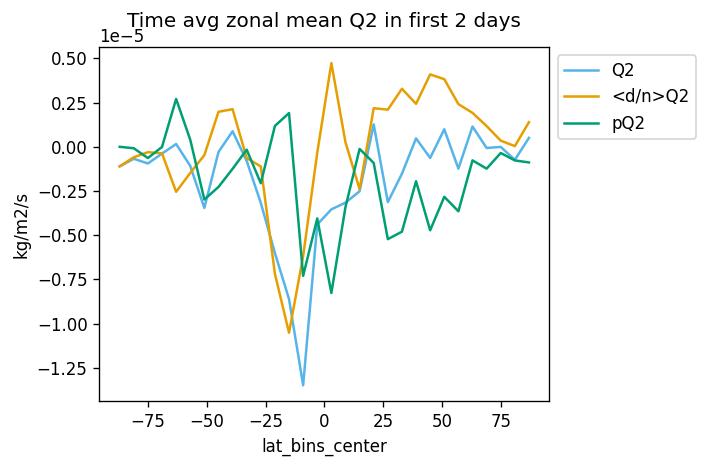

In [176]:
zonal_diff_ds.q2.mean(dim="time").plot(label="Q2")
zonal_diff_ds["<d/n>q2"].mean(dim="time").plot(label="<d/n>Q2")
zonal_diff_ds.pq2.mean(dim="time").plot(label="pQ2")
plt.title("Time avg zonal mean Q2 in first 2 days", pad=12)
plt.ylabel("kg/m2/s")

plt.legend(bbox_to_anchor=(1,1))
plt.tight_layout()
plt.show()